# Mapping data in Python

This tutorial will take you how to create both static and interactive maps in Python using GeoPandas and the Folium libraries.


Let's start by importing all the necessary libraries we'll need:
- [Geopandas](https://geopandas.org/index.html): similar to pandas with extensions to make it easier to work  with geospatial data.
- [Folium](https://python-visualization.github.io/folium/): A library for creating interactive maps that is an extension of the Leaflet.js Javascript library
- [Matplotlib](https://matplotlib.org/): the defacto library for drawing/plotting in Python
- [Psycopg2](https://www.psycopg.org/docs/): is a utility library that makes it easier to connect to postgresql
- [Cenpy](https://github.com/cenpy-devs/cenpy): An interface to explore and download US Census data

In [26]:
import geopandas as gpd
import folium
import matplotlib.pyplot as plt
import psycopg2 as pg
import cenpy
import pandas as pd
import numpy as np
import os

In the next step we'll need to connect to the class database that lives on AWS. This database has all of the geographic geometry that we'll plot in Python.

In [2]:
conn = pg.connect(
    host=os.environ['aws_db_host'],
    port="5432",
    user=os.environ['aws_db_u'],
    password=os.environ['aws_db_p']
)

Once connected to the database we can write a simple SQL query to download blockgroup geometries for NYC. We can use the convenient **read_postgis** function in Geopandas to return the geometry as a GeoDataFrame, which is similar to a Pandas DataFrame, but with a few more convenient methods for geospatial data.

In the SQL query we add a WHERE clause that filters blockgroup geometries by their state and county – which is represented in the first 5 characters. To return NYC only geometry, that means we will only include blockgroups that start with the following:
- 36005: Bronx
- 36047: Brooklyn / Kings
- 36061: Manhattan / New York
- 36081: Queens
- 36085: Staten Island / Richmond

In [3]:
gdf = gpd.read_postgis('''
    SELECT 
        region_id,
        geom AS geom,
        aland,
        awater
    FROM geographies.blockgroups
    WHERE SUBSTRING(region_id, 1, 5) IN ('36005', '36047', '36061', '36081', '36085')
    ''', conn)

In [4]:
print(gdf.shape)
gdf.head(3)

(6493, 4)


,region_id,geom,aland,awater
0,360810136001,"POLYGON ((-73.83066 40.70860, -73.83076 40.708...",100818,0
1,360470896001,"POLYGON ((-73.91413 40.66018, -73.91374 40.658...",41857,0
2,360610015010,"POLYGON ((-74.00217 40.70632, -74.00255 40.706...",0,175058


We can see from the above cell that there are 6,493 blockgroups in New York's 5 boroughs. 

We can plot the contents of a GeoDataFrame to see the NYC blockgroup geometry.

<AxesSubplot:>

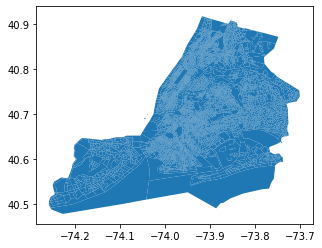

In [5]:
gdf.plot()

We can use Matplotlib together with the GeoPandas plot function to neaten up the above plot – remove redundant blockgroups that are entirely water, remove the axis, and enlarge it. We will create a new column within the gdf GeoDataFrame called 'water_pct' which will be the ration of water to land, and use that to remove blockgroups that over 65% water.

We can also set line weight, line color and fill color properties in the plot function to make it even more readable.

In [6]:
gdf['water_pct'] = gdf['awater'] / gdf['aland']

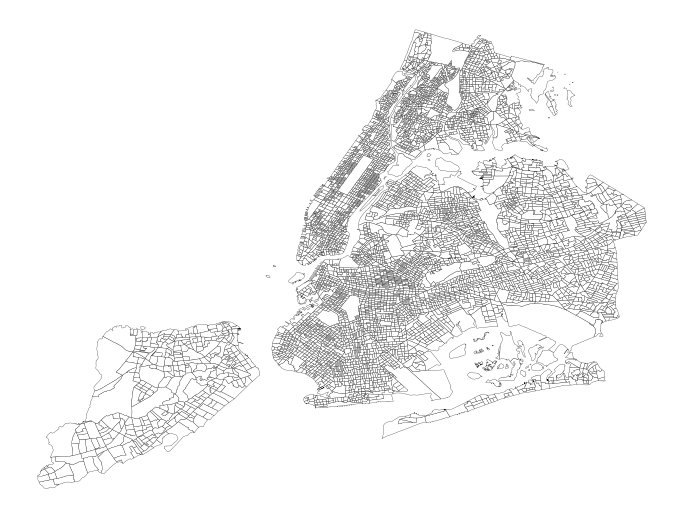

In [7]:
fig, ax = plt.subplots(figsize=(12,12))
gdf[gdf['water_pct'] < 0.65].plot(ax=ax, edgecolor='black', 
                                  lw=0.25, facecolor='white')
_ = plt.axis(False)

Now that we have visualized geometry, it is time to add another variables to color the geometries with. For this we will download income data from the US Census using Cenpy.

To begin we connect to the API and specify the year we're interested in – as of writing this the latest year Cenpy has access to is 2018.

In [8]:
cenn = cenpy.products.APIConnection("ACSDT5Y2018")

Next we will query the Cenpy interface specifying the variable of interest, the geographic unit, and state/county. 

The Cenpy library has access to hundreds of US Census variables–things like race, age, gender, employment type, etc– and it has helper functions to help users search for the topics they're interested in. This tutorial will specifically get income data which is code **B19013_001E**. Use [this table](https://github.com/carlobailey/urban-data-science/blob/master/ACS/table_name_variables.md) to search for additional variables you may be interested in such.

We will use the NYC county and state codes used previously to specify the geographic region (36047, 36005, etc...).

Because you can only specify one geographic region at a time in Cenpy, we will create a simple for loop to iterate over the 5 counties of NYC and use the Pandas **concat** function to merge the resulting DataFrames.

In [9]:
counties = ['005', '047', '061', '081', '085']
dfs = []

for county in counties:
    dfs.append(
        cenn.query(['B19013_001E'], 
                   geo_unit='block group', 
                   geo_filter={"state": '36', 
                               "county": county})
    )
df = pd.concat(dfs)

Strangely, often Census data downloaded via Cenpy is not in the correct data format. Below shows that all the columns of a string type. This is obviously problematic as income should be a numeric variable, so we will have to specify it as a float column below.

In [10]:
df.dtypes

B19013_001E    object
state          object
county         object
tract          object
block group    object
dtype: object

In [11]:
df['B19013_001E'] = df['B19013_001E'].astype(float)

Another oddity with Census data is that missing values are often given a very large or very small number. This will throw off any visualization or analysis we intend to do with the data so we will have to remove these values.

The below cell replaces all missing values (-666666666.0) with the more conventional NULL / NaN values using the Numpy library.

In [12]:
df = df.replace(-666666666.0, np.nan)

In [13]:
print(df.shape)
df.head()

(6493, 5)


,B19013_001E,state,county,tract,block group
0,30500.0,36,005,024502,3
1,44524.0,36,005,024700,2
2,36250.0,36,005,025300,4
3,12351.0,36,005,026300,5
4,38099.0,36,005,026500,4


To plot the above income data on a map we'll need to merge it with the blockgroup geometries downloaded previously.

To do this we need to create a **region_id** column in the df variable that combines the state, county, tract and blockgroup columns above into a single ID, that is the same as the region_id column in our GeoDataFrame. Then we can use the **merge** method to combine rows.

In [92]:
df['region_id'] = df['state'] + df['county'] + df['tract'] + df['block group']

combined = gdf.merge(df, on='region_id')

In [93]:
print(combined.shape)
combined.head()

(6493, 10)


,region_id,geom,aland,awater,water_pct,B19013_001E,state,county,tract,block group
0,360810136001,"POLYGON ((-73.83066 40.70860, -73.83076 40.708...",100818,0,0.0,76151.0,36,081,013600,1
1,360470896001,"POLYGON ((-73.91413 40.66018, -73.91374 40.658...",41857,0,0.0,41940.0,36,047,089600,1
2,360610015010,"POLYGON ((-74.00217 40.70632, -74.00255 40.706...",0,175058,inf,NaN,36,061,001501,0
3,360471156002,"POLYGON ((-73.89763 40.66742, -73.89723 40.665...",41898,0,0.0,14324.0,36,047,115600,2
4,360470269001,"POLYGON ((-73.94375 40.68251, -73.94360 40.681...",39750,0,0.0,115461.0,36,047,026900,1


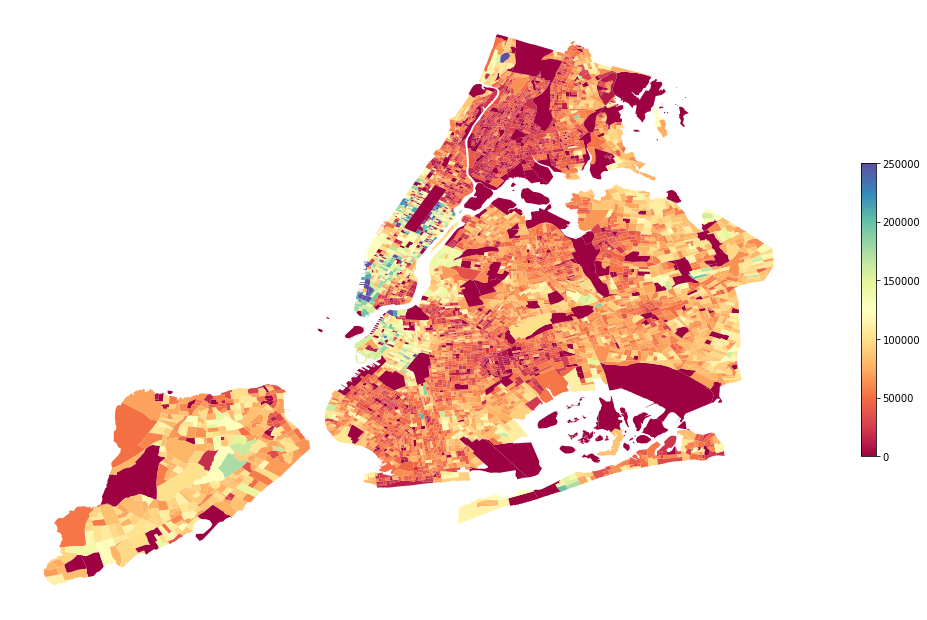

In [94]:
combined.fillna(0, inplace=True)
fig, ax = plt.subplots(figsize=(18, 18))
combined[combined['water_pct'] < 0.65].plot(
    ax=ax, column='B19013_001E', legend=True,
    legend_kwds={'shrink': 0.3}, cmap='Spectral')
_ = plt.axis(False)

### Interactive maps

Next we will implement an interactive map with Folium. The first step will be to create a map object with Folium and specify where our map is located on Earth by providing the centroid of our GeoDataFrame. We also have to specify the tiles for our map – this is the style of the map layer.

In [95]:
x = combined.centroid.x.mean()
y = combined.centroid.y.mean()
f_map = folium.Map(location=[y, x], zoom_start=11, tiles='CartoDB positron')

In [40]:
f_map

Now we can use the built in choropleth method in Folium to visualize income data on the above map.

The choropleth method takes 3 arguments:
- geo_data: the geographic geometry (GeoDataFrame)
- data: the values to color the choropleth with
- columns: the specific column to use

In [96]:
combined.crs = "EPSG:4326"
combined = combined[combined['water_pct'] < 0.65]

In [97]:
folium.Choropleth(
    geo_data=combined,
    data=combined,
    columns=['region_id', 'B19013_001E'],
    key_on='feature.properties.region_id',
    fill_color='RdYlBu',
    fill_opacity=1,
    line_opacity=0.15,
    legend_name='Median Income'
).add_to(f_map)
f_map

The final step is to add interactivity to the map. To do that we have to take advantage of the Folium **features.GeoJson** method to specify mouse actions on hover.

The method takes the following parameters:
- GeoDataFrame
- tooltip: the fields to use, the aliases to give the fields, and styling
- highlight_function: how to style the underlying geometry on hover

In [98]:
style_fnc = lambda x: {'fillColor': '#ffffff', 
                       'color':'#000000', 
                       'fillOpacity': 0.1, 
                       'weight': 0.1}
highlight_fnc = lambda x: {'fillColor': '#000000', 
                           'color':'#000000', 
                           'fillOpacity': 0.50, 
                           'weight': 0.1}
interact = folium.features.GeoJson(
    combined,
    style_function=style_fnc, 
    control=False,
    highlight_function=highlight_fnc, 
    tooltip=folium.features.GeoJsonTooltip(
        fields=['region_id', 'B19013_001E'],
        aliases=['Blockgroup: ','Median Income ($): '],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;") 
    )
)
f_map.add_child(interact)
f_map.keep_in_front(interact)
folium.LayerControl().add_to(f_map)
f_map

We can end by exporting the interactive map as a html file to use in a seperate webpage